In [1]:
%%HTML
<style> code {background-color : pink !important;} </style>

# Camera Calibration

In [2]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import pickle
%matplotlib qt

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/cal*.jpg')

# Step through the list and search for chessboard corners
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        cv2.drawChessboardCorners(img, (9,6), corners, ret)
        #write_name = 'corners_found'+str(idx)+'.jpg'
        #cv2.imwrite(write_name, img)
        cv2.imshow('img', img)
        cv2.waitKey(500)

cv2.destroyAllWindows()

### Use the image points and obj points to calibrate the camera.

undist_image_name test_images/undist_test1.jpg
undist_image_name test_images/undist_test2.jpg
undist_image_name test_images/undist_test3.jpg
undist_image_name test_images/undist_test4.jpg
undist_image_name test_images/undist_test5.jpg
undist_image_name test_images/undist_test6.jpg


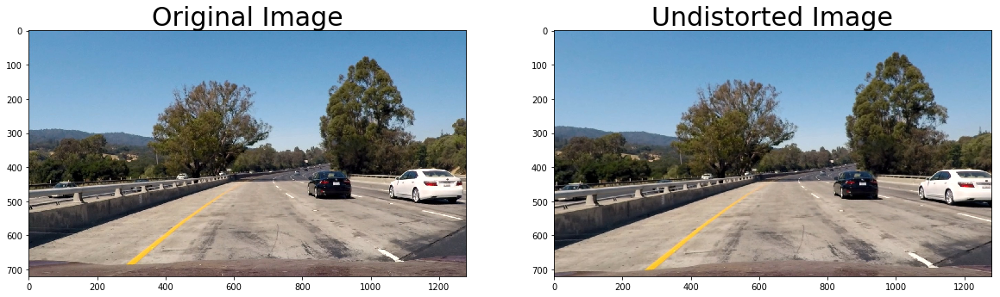

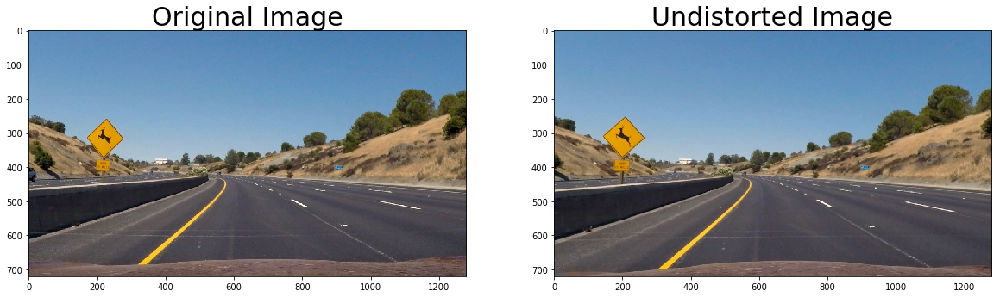

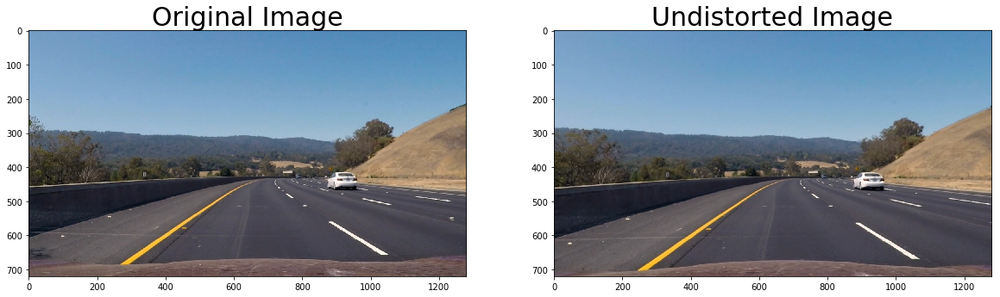

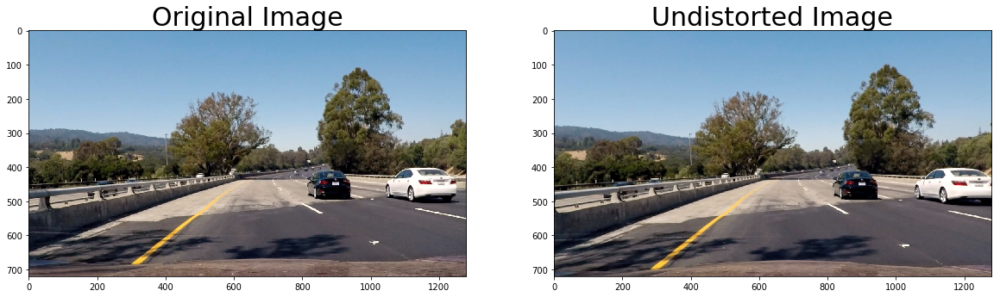

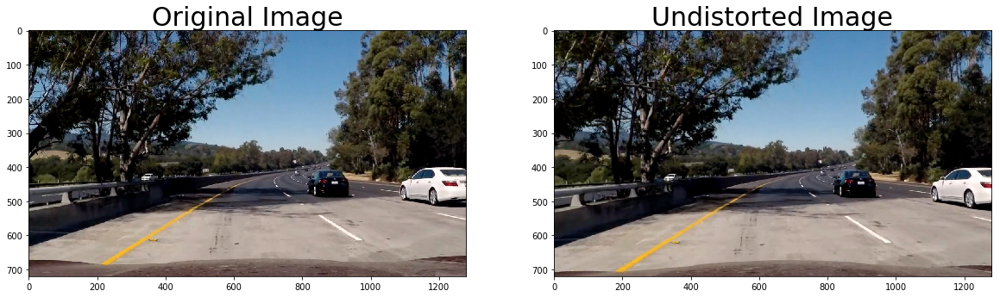

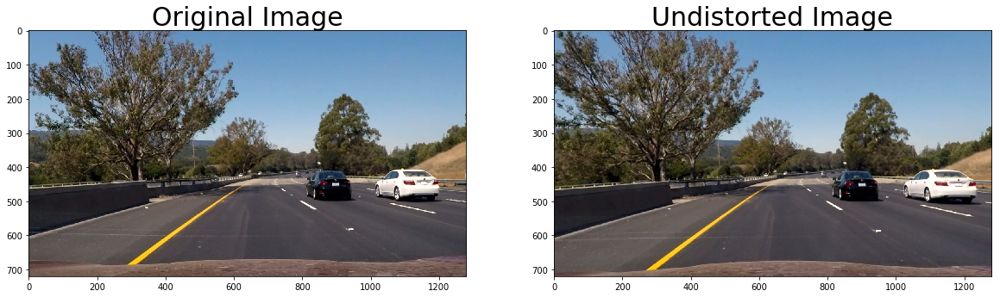

In [3]:
%matplotlib inline
test_images = glob.glob('test_images/test*.jpg')
for test_image in test_images:
    test_image_name = test_image.split('\\')[-1]
    test_img = cv2.imread(test_image)
    img_size = (test_img.shape[1], test_img.shape[0])
    
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)
    dst = cv2.undistort(test_img, mtx, dist, None, mtx)
    undist_image_name = test_image.split('\\')[0] +'/undist_' + test_image_name
    print('undist_image_name', undist_image_name)
    cv2.imwrite(undist_image_name,dst)
    dist_pickle = {}
    dist_pickle["mtx"] = mtx
    dist_pickle["dist"] = dist
    pickle.dump( dist_pickle, open( "camera_cal/wide_dist_pickle.p", "wb" ) )
    test_img = cv2.cvtColor(test_img, cv2.COLOR_BGR2RGB)
    dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(test_img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(dst)
    ax2.set_title('Undistorted Image', fontsize=30)


In [4]:
def corners_unwarp(img, nx, ny, mtx, dist):
    # Use the OpenCV undistort() function to remove distortion
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    # Convert undistorted image to grayscale
    gray = cv2.cvtColor(undist, cv2.COLOR_BGR2GRAY)
    # Search for corners in the grayscaled image
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
    print('return', ret)
    if ret == True:
        # If we found corners, draw them! (just for fun)
        cv2.drawChessboardCorners(undist, (nx, ny), corners, ret)
        # Choose offset from image corners to plot detected corners
        # This should be chosen to present the result at the proper aspect ratio
        # My choice of 100 pixels is not exact, but close enough for our purpose here
        offset = 70 # offset for dst points
        # Grab the image shape
        img_size = (gray.shape[1], gray.shape[0])
        # For source points I'm grabbing the outer four detected corners
        src = np.float32([corners[0], corners[nx-1], corners[-1], corners[-nx]])
        # For destination points, I'm arbitrarily choosing some points to be
        # a nice fit for displaying our warped result 
        # again, not exact, but close enough for our purposes
        dst = np.float32([[offset, offset], [img_size[0]-offset, offset], 
                                     [img_size[0]-offset, img_size[1]-offset], 
                                     [offset, img_size[1]-offset]])
        # Given src and dst points, calculate the perspective transform matrix
        M = cv2.getPerspectiveTransform(src, dst)
        # Warp the image using OpenCV warpPerspective()
        warped = cv2.warpPerspective(undist, M, img_size)
        return warped, M



return True


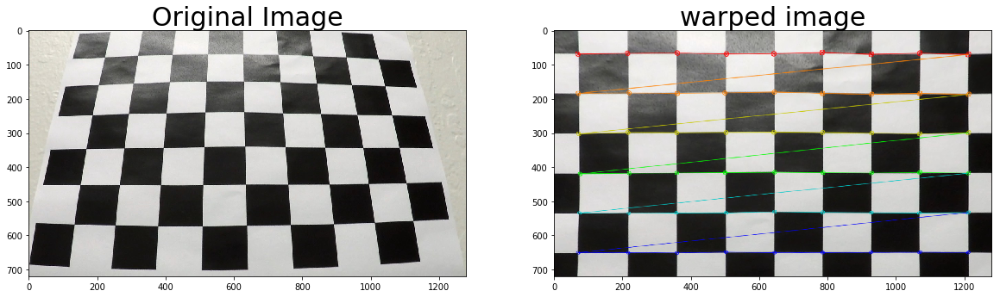

In [5]:
image = cv2.imread('camera_cal/calibration3.jpg')
warped_image, M = corners_unwarp(image,9,6,mtx,dist)
# Visualize warp for chessboard
image = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
warped_image = cv2.cvtColor(warped_image,cv2.COLOR_BGR2RGB)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(warped_image)
ax2.set_title('warped image', fontsize=30)


### I will apply perspective transformation now to test the image. I will again define this as a function later and use it as part of the pipeline.

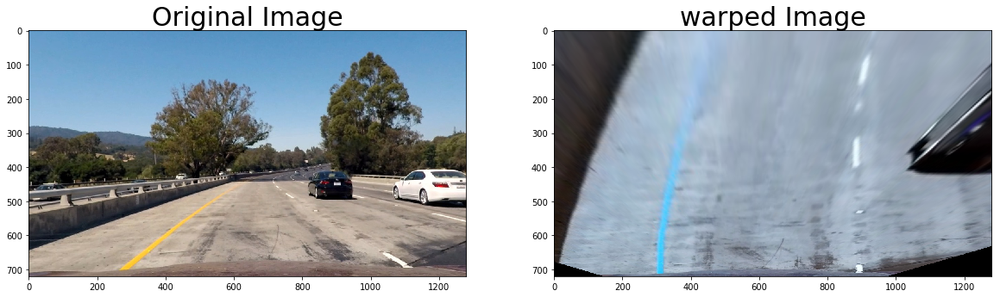

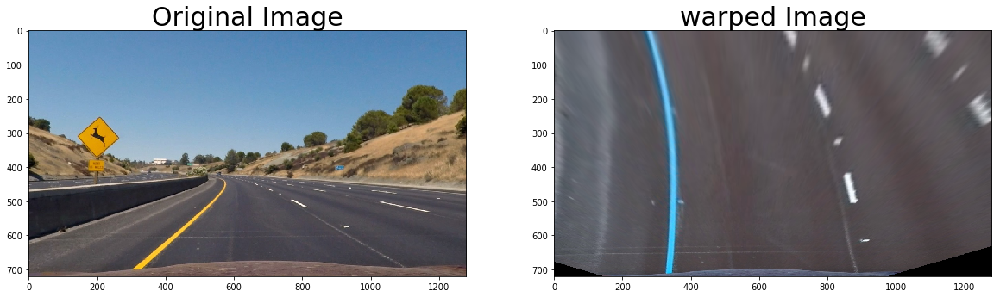

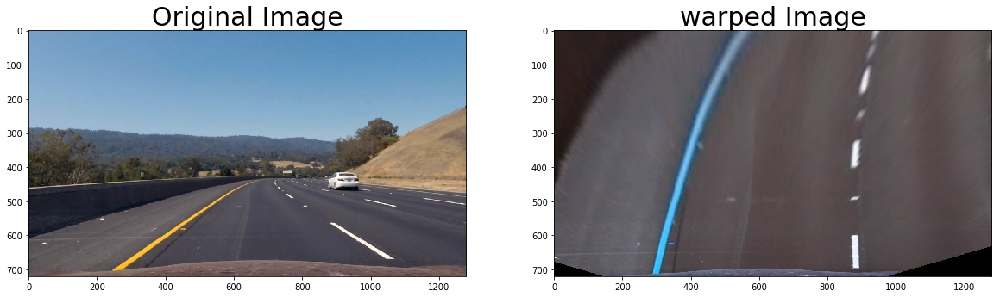

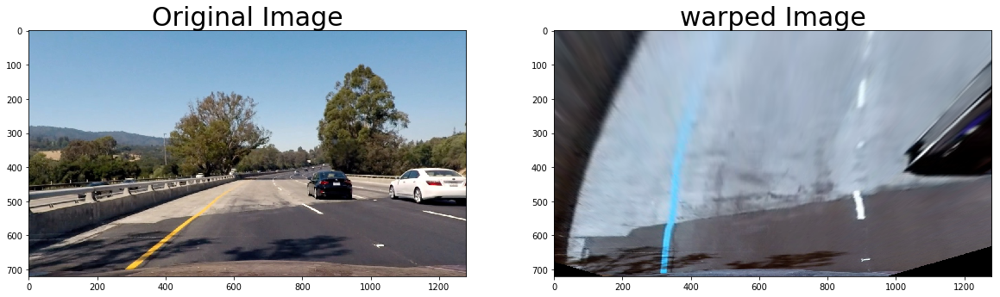

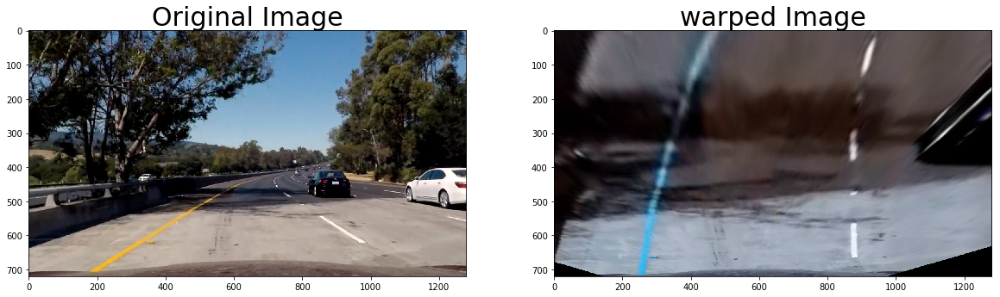

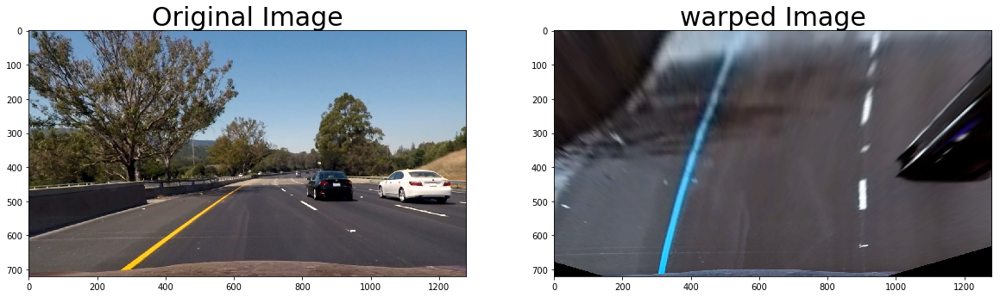

In [6]:
undist_test_images = glob.glob('test_images/undist*.jpg')

warped_test_images = []

for undist_test_image in undist_test_images:
    undist_test_img = cv2.imread(undist_test_image)
    src_coords = np.float32([[240,719],
                         [579,450],
                         [712,450],
                         [1165,719]])
    dst_coords = np.float32([[300,719],
                         [300,0],
                         [900,0],
                         [900,719]])
    M = cv2.getPerspectiveTransform(src_coords,dst_coords)
    img_size = (undist_test_img.shape[1], undist_test_img.shape[0])
    warped_test_image = cv2.warpPerspective(undist_test_img, M, img_size)
    undist_test_image = cv2.cvtColor(undist_test_img, cv2.COLOR_BGR2RGB)
    # Visualize perspective transformation
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(undist_test_image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(warped_test_image)
    ax2.set_title('warped Image', fontsize=30)
    warped_test_images.append(warped_test_image)



###  Applying SOBEL edge dection to find the lanes

In [7]:

def abs_sobel_thresh(img, orient='x', sobel_kernel = 3,thresh_min=0, thresh_max=255):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0,ksize=sobel_kernel))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1,ksize=sobel_kernel))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
        # Return the result
    return binary_output

### Applying Color filter here

In [8]:
def thresh_binary(img, thresh_min, thresh_max):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    thresh_binary = np.zeros_like(s_channel)
    s_thresh = cv2.inRange(s_channel.astype('uint8'), thresh_min, thresh_max)
    return s_thresh   


### Combining Sobel and color filter here

In [9]:
def stack_binary(img):
    sx_thresh = abs_sobel_thresh(undist_test_img,orient = 'x',sobel_kernel = 3,thresh_min = 20, thresh_max = 150)
    s_thresh = thresh_binary(undist_test_img,thresh_min = 70, thresh_max = 250)
    color_binary = np.dstack(( np.zeros_like(sx_thresh), sx_thresh, s_thresh))
    return color_binary
    

### Testing SOBEL threshold here

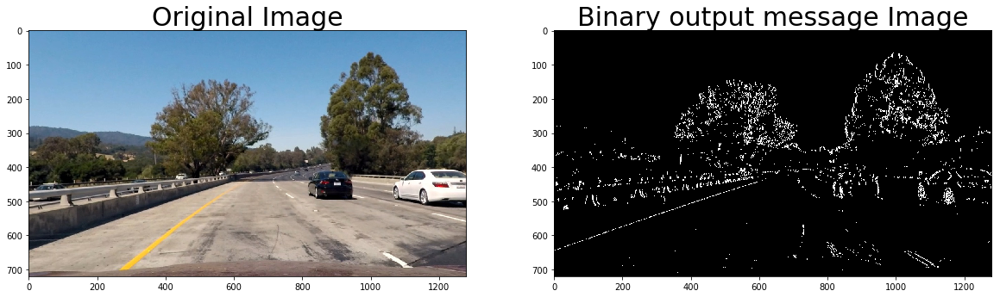

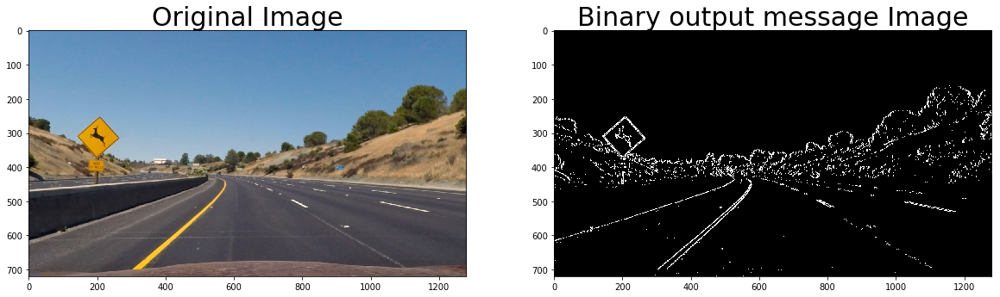

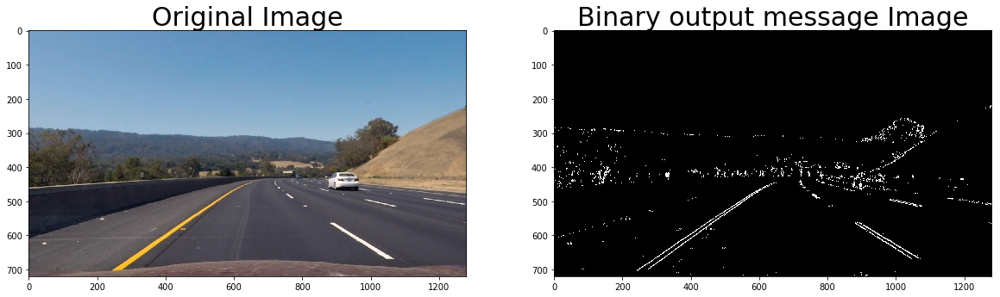

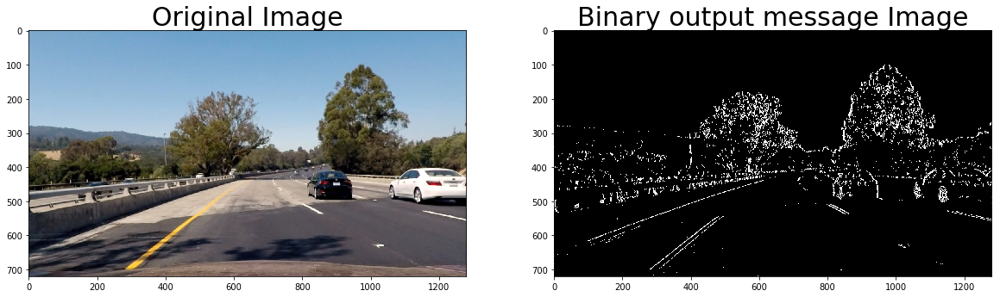

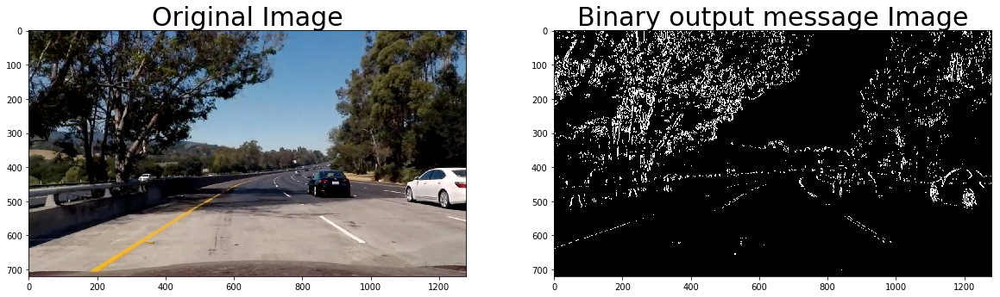

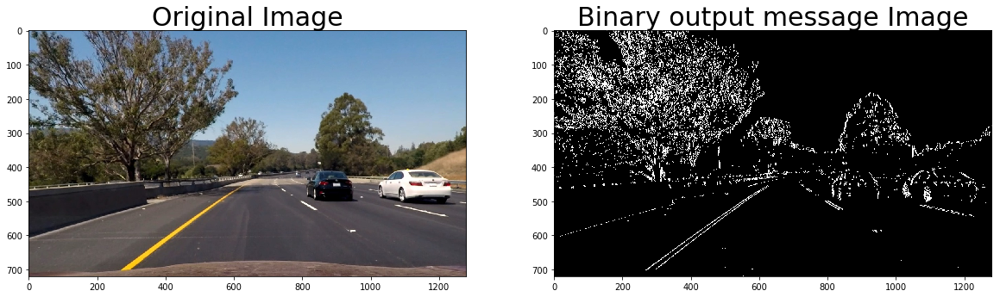

In [10]:
for undist_test_image in undist_test_images:
    undist_test_img = cv2.imread(undist_test_image)
    thresh_image = abs_sobel_thresh(undist_test_img,orient = 'x',sobel_kernel = 3,thresh_min = 30, thresh_max = 150)
    undist_test_image = cv2.cvtColor(undist_test_img,cv2.COLOR_BGR2RGB)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(undist_test_image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(thresh_image, cmap = 'gray')
    ax2.set_title('Binary output message Image',fontsize=30)
    #warped_test_images.append(warped_test_image)

    

### Testing Color filter here.

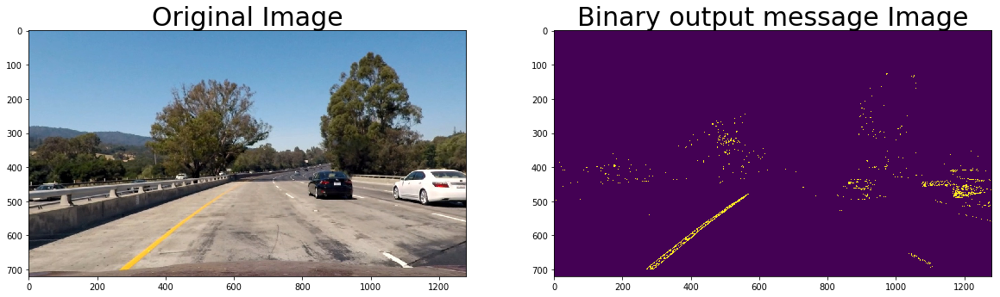

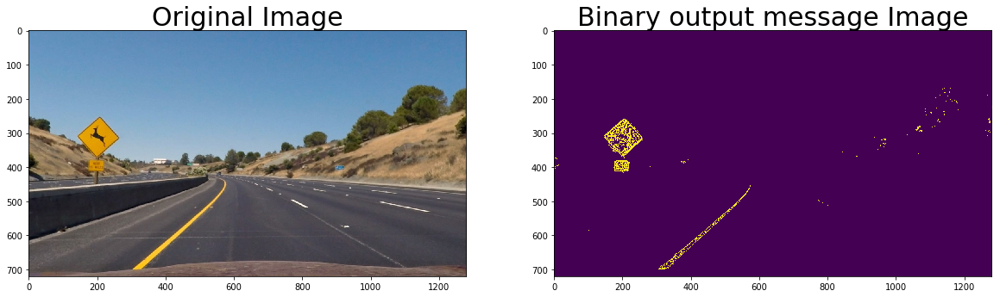

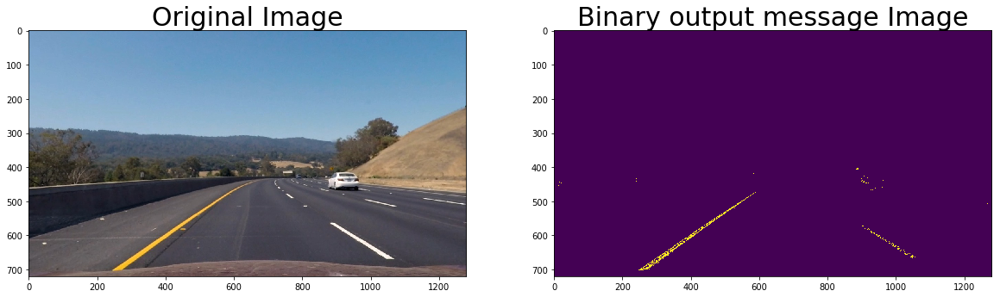

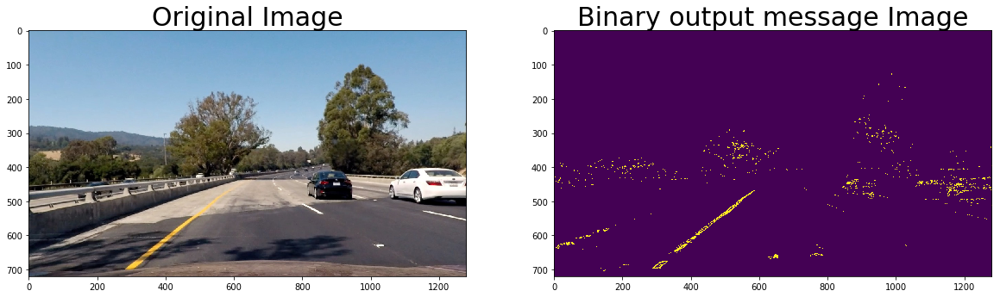

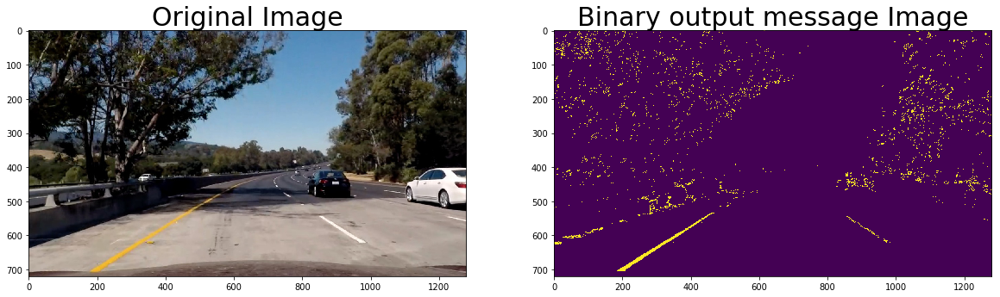

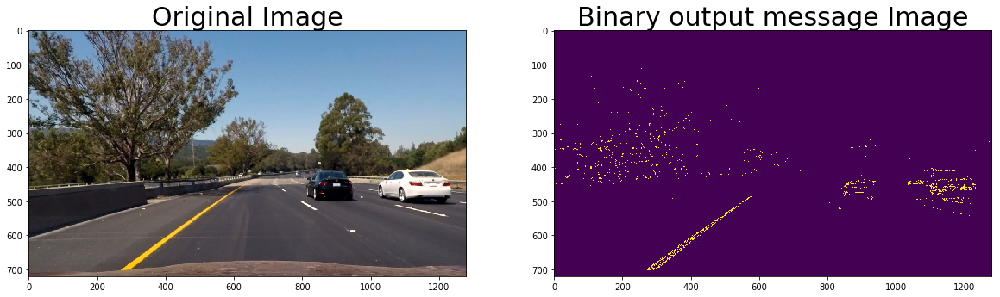

In [11]:
for undist_test_image in undist_test_images:
    undist_test_img = cv2.imread(undist_test_image)
    thresh_image = thresh_binary(undist_test_img,thresh_min = 175, thresh_max = 250)
    # Visualize undistortion
    undist_test_image = cv2.cvtColor(undist_test_img,cv2.COLOR_BGR2RGB)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(undist_test_image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(thresh_image)
    ax2.set_title('Binary output message Image', fontsize=30)
    #warped_test_images.append(warped_test_image)

    

### Combining both SOBEL and Color threshold

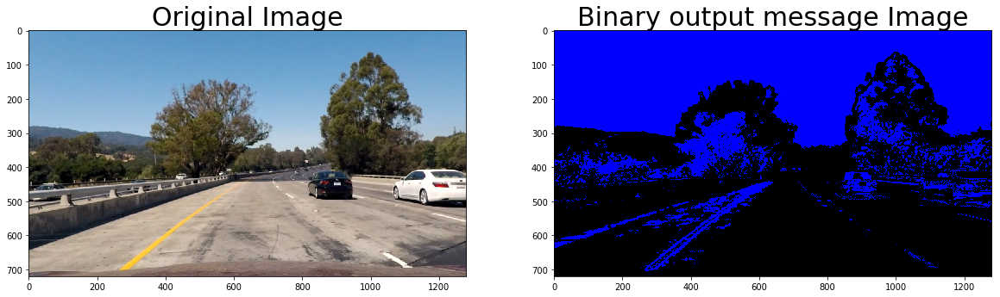

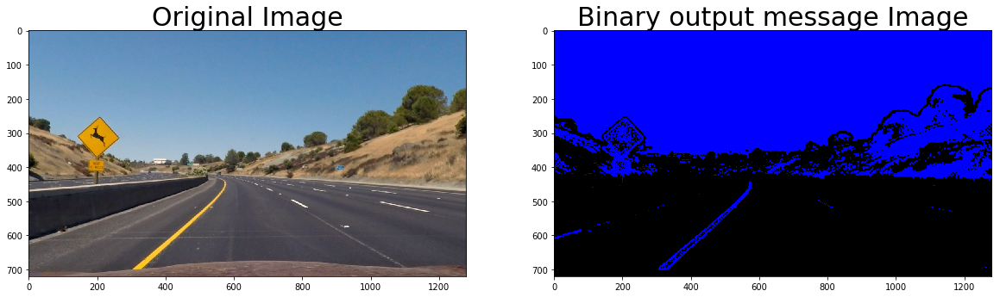

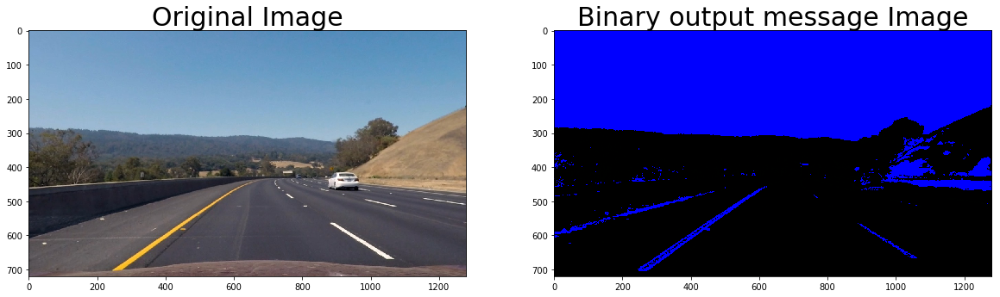

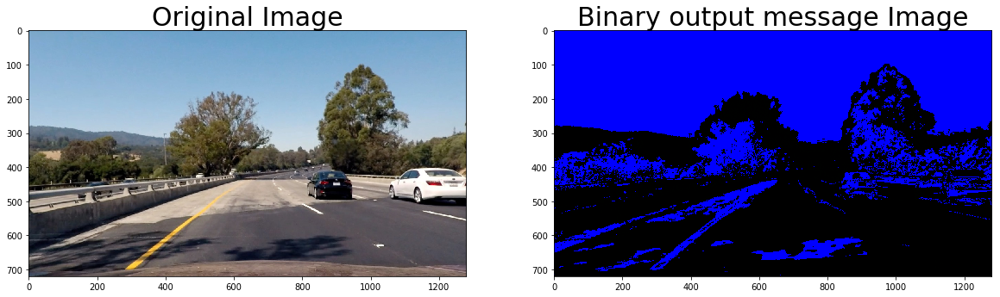

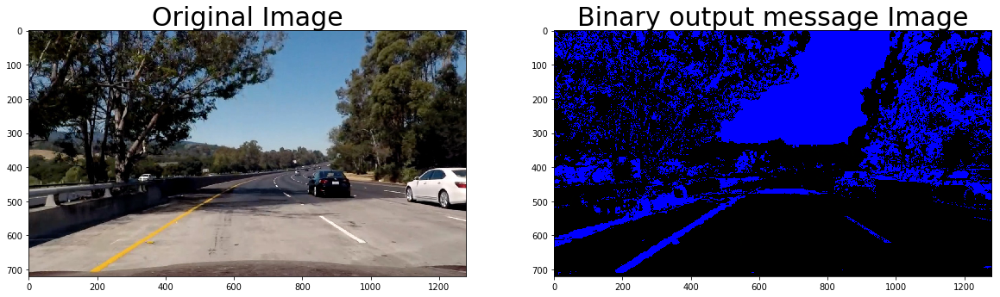

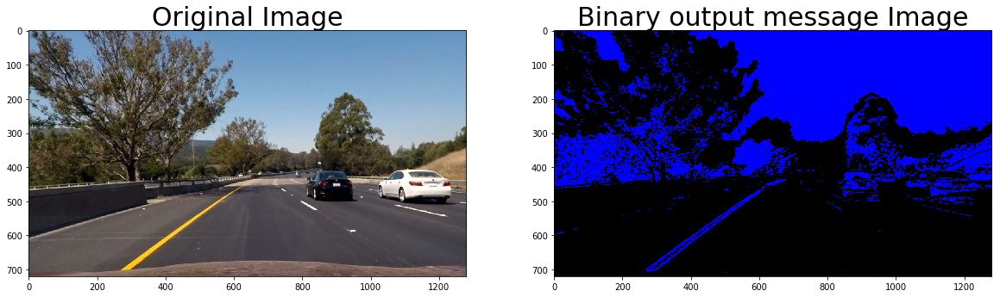

In [12]:
for undist_test_image in undist_test_images:
    undist_test_img = cv2.imread(undist_test_image)
    stack_binary_image = stack_binary(undist_test_img)
    undist_test_image = cv2.cvtColor(undist_test_img,cv2.COLOR_BGR2RGB)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(undist_test_image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(stack_binary_image)
    ax2.set_title('Binary output message Image', fontsize=30)
    #warped_test_images.append(warped_test_image)


### Applying perspective transfrom to the previous output.

In [13]:
def warp_image(img,src,dst,img_size):
    # Apply perspective transform
    M = cv2.getPerspectiveTransform(src, dst)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    Minv = cv2.getPerspectiveTransform(dst, src)

    return warped,M,Minv



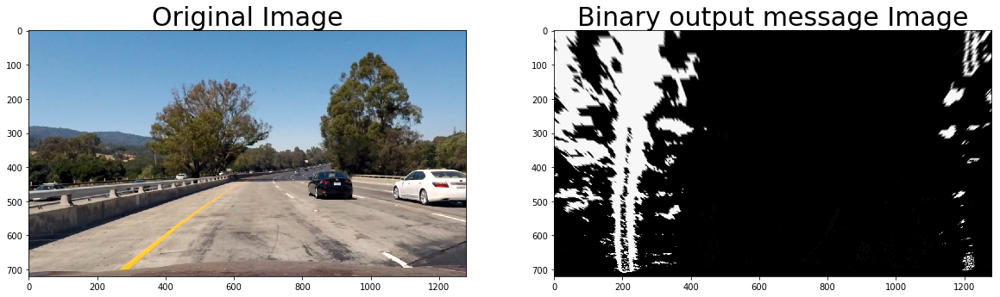

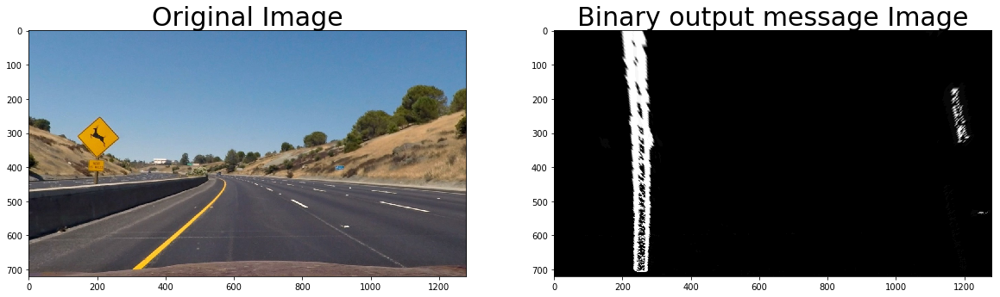

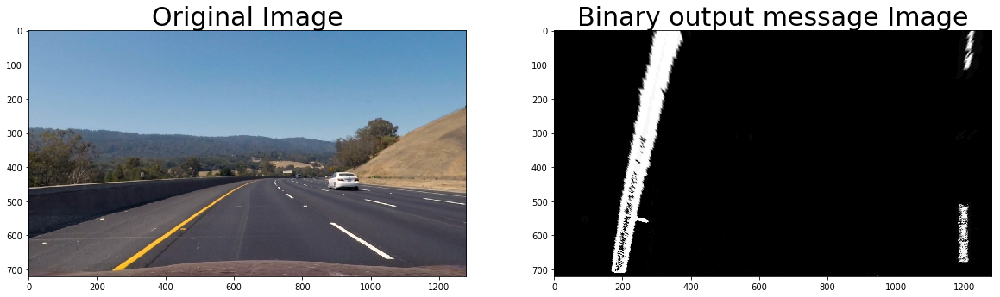

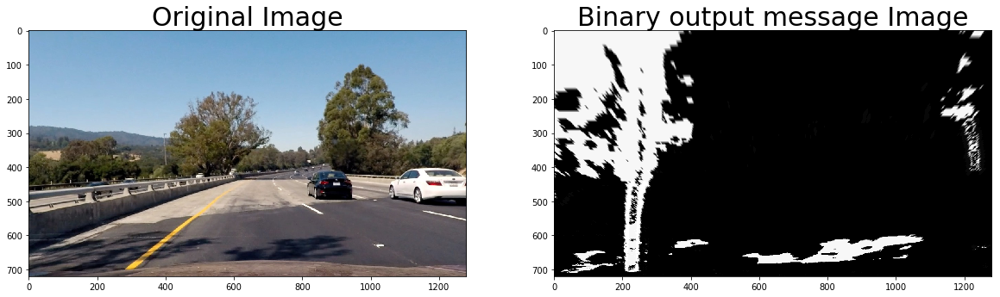

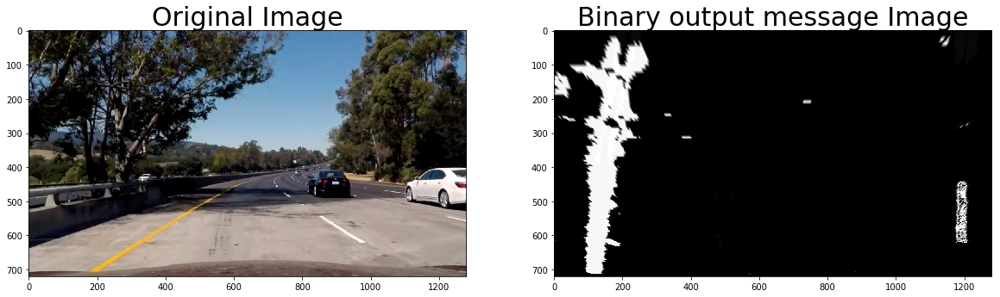

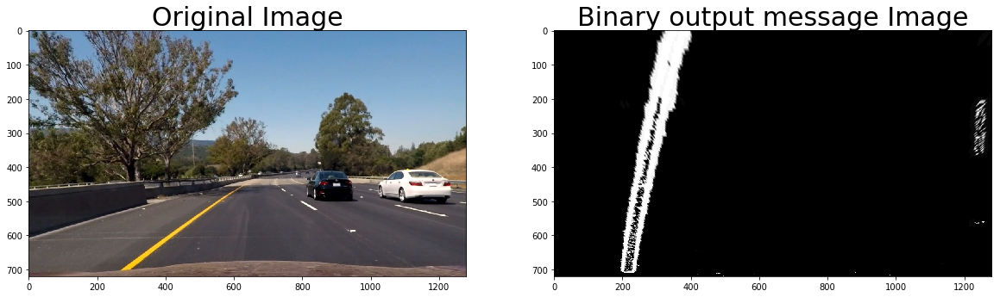

In [14]:
for undist_test_image in undist_test_images:
    undist_test_img = cv2.imread(undist_test_image)
    stack_binary_image = stack_binary(undist_test_img)
    img_size = stack_binary_image.shape
    ht_window = np.uint(img_size[0]/1.5)
    hb_window = np.uint(img_size[0])
    c_window = np.uint(img_size[1]/2)
    ctl_window = c_window - .2*np.uint(img_size[1]/2)
    ctr_window = c_window + .2*np.uint(img_size[1]/2)
    cbl_window = c_window - .9*np.uint(img_size[1]/2)
    cbr_window = c_window + .9*np.uint(img_size[1]/2)
    src = np.float32([[cbl_window,hb_window],[cbr_window,hb_window],[ctr_window,ht_window],[ctl_window,ht_window]])

    dst = np.float32([[0,img_size[0]],[img_size[1],img_size[0]],
                  [img_size[1],0],[0,0]])

    warped,M_warp,Minv_warp = warp_image(stack_binary_image,src,dst,(img_size[1],img_size[0]))
    undist_test_image = cv2.cvtColor(undist_test_img,cv2.COLOR_BGR2RGB)
    warped = cv2.cvtColor(warped,cv2.COLOR_RGB2GRAY)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(undist_test_image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(warped,cmap='gray')
    ax2.set_title('Binary output message Image', fontsize=30)
    #warped_test_images.append(warped_test_image)


### The right lane is not visible clearly. Let me apply separate color mask for yellow lane and white lane and see. I will apply guassian blur if this does not give me good result.

In [15]:
def apply_color_mask(hsv,img,low,high):
    # Apply color mask to image
    mask = cv2.inRange(hsv, low, high)
    res = cv2.bitwise_and(img,img, mask= mask)
    return res
def color_mask(hsv,low,high):
    # Return mask from HSV 
    mask = cv2.inRange(hsv, low, high)
    return mask

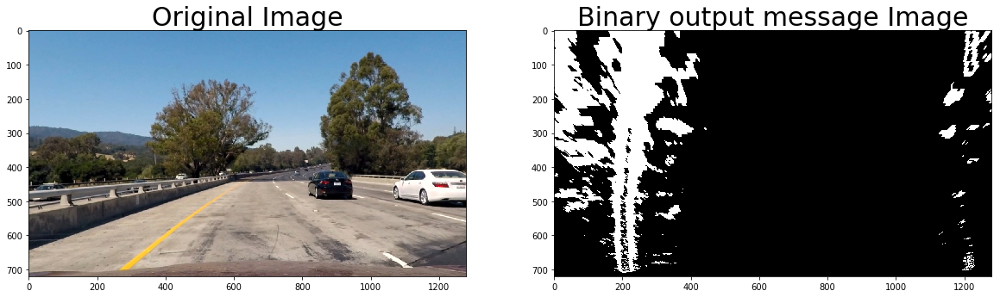

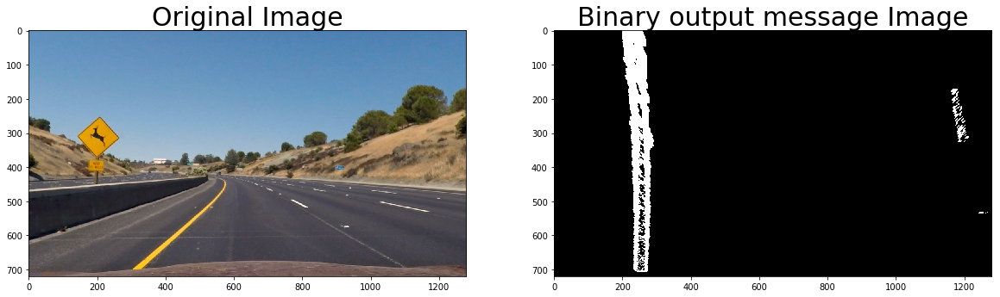

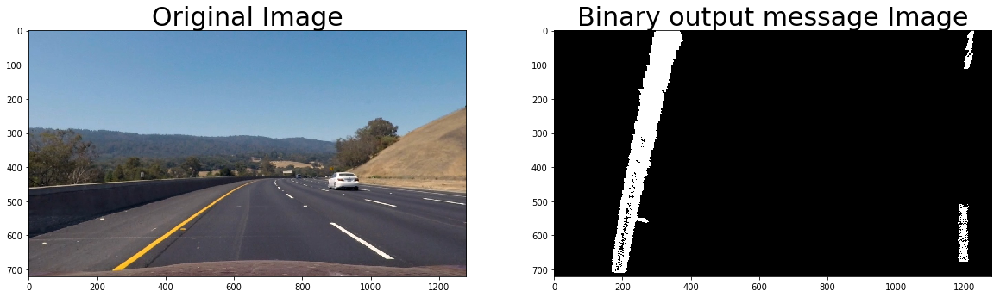

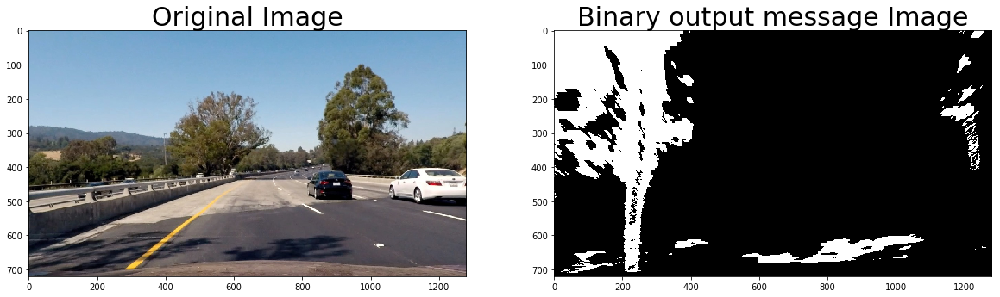

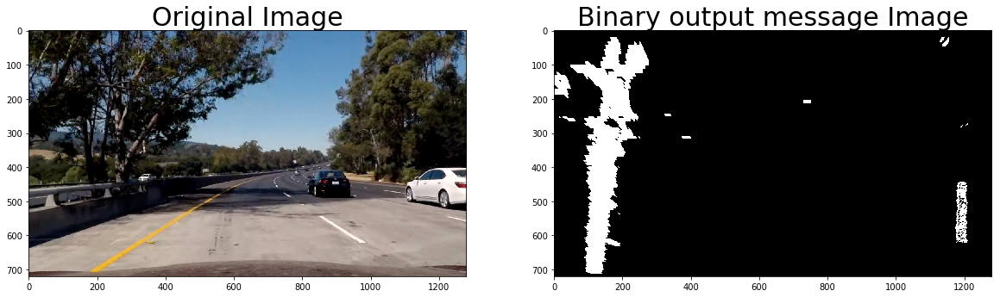

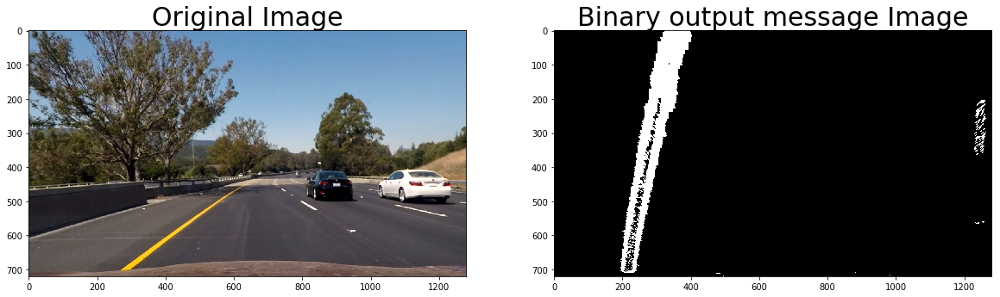

In [16]:
for undist_test_image in undist_test_images:
    undist_test_img = cv2.imread(undist_test_image)
    stack_binary_image = stack_binary(undist_test_img)
    img_size = stack_binary_image.shape
    ht_window = np.uint(img_size[0]/1.5)
    hb_window = np.uint(img_size[0])
    c_window = np.uint(img_size[1]/2)
    ctl_window = c_window - .2*np.uint(img_size[1]/2)
    ctr_window = c_window + .2*np.uint(img_size[1]/2)
    cbl_window = c_window - .9*np.uint(img_size[1]/2)
    cbr_window = c_window + .9*np.uint(img_size[1]/2)
    src = np.float32([[cbl_window,hb_window],[cbr_window,hb_window],[ctr_window,ht_window],[ctl_window,ht_window]])

    dst = np.float32([[0,img_size[0]],[img_size[1],img_size[0]],
                  [img_size[1],0],[0,0]])

    warped,M_warp,Minv_warp = warp_image(stack_binary_image,src,dst,(img_size[1],img_size[0]))
    image_HSV = cv2.cvtColor(warped,cv2.COLOR_BGR2HSV)
    yellow_hsv_low  = np.array([ 0,  100,  100])
    yellow_hsv_high = np.array([ 80, 255, 255])
    #res_mask = color_mask(image_HSV,yellow_hsv_low,yellow_hsv_high)
    #res = apply_color_mask(image_HSV,warped,yellow_hsv_low,yellow_hsv_high)
    white_hsv_low  = np.array([ 0,   0,   160])
    white_hsv_high = np.array([ 255,  80, 255])

    #white_hsv_low  = np.array([  0,   0,    80])
    #white_hsv_high = np.array([ 255,  255, 255])

    #res1 = apply_color_mask(image_HSV,warped,white_hsv_low,white_hsv_high)
    mask_yellow = color_mask(image_HSV,yellow_hsv_low,yellow_hsv_high)
    mask_white = color_mask(image_HSV,white_hsv_low,white_hsv_high)
    mask_lane = cv2.bitwise_or(mask_yellow,mask_white)

    undist_test_image = cv2.cvtColor(undist_test_img,cv2.COLOR_BGR2RGB)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(undist_test_image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(mask_lane,cmap='gray')
    ax2.set_title('Binary output message Image', fontsize=30)
    #warped_test_images.append(warped_test_image)


### It seems there is not much improvement. I will apply Gaussian blur to the images and again do the same to see if there is any change.

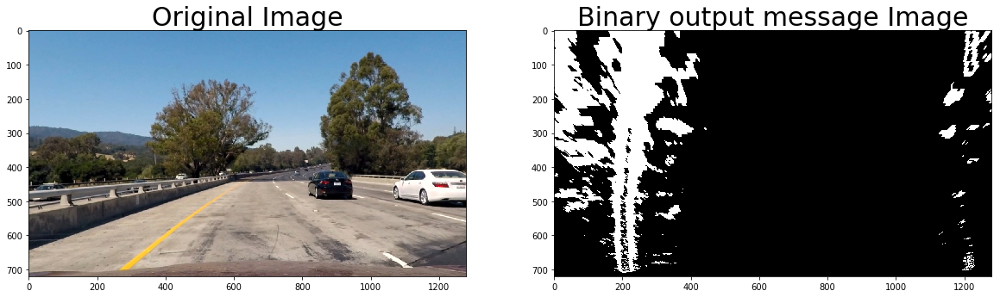

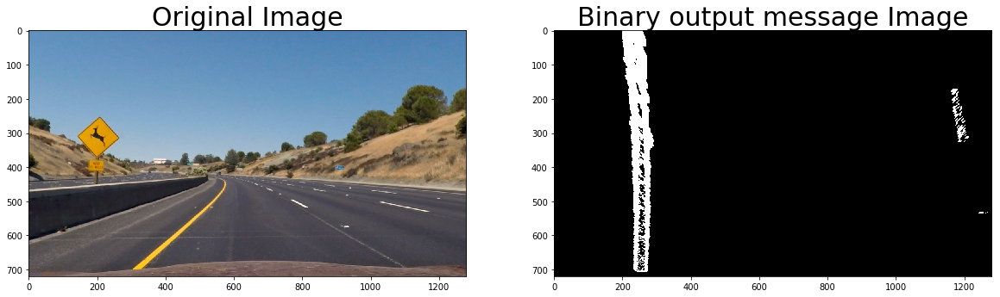

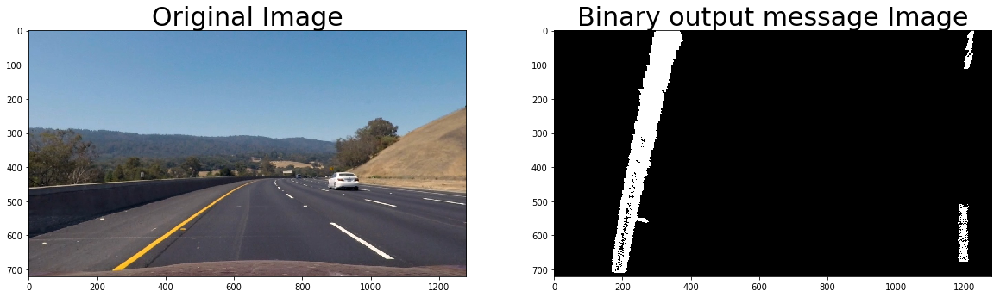

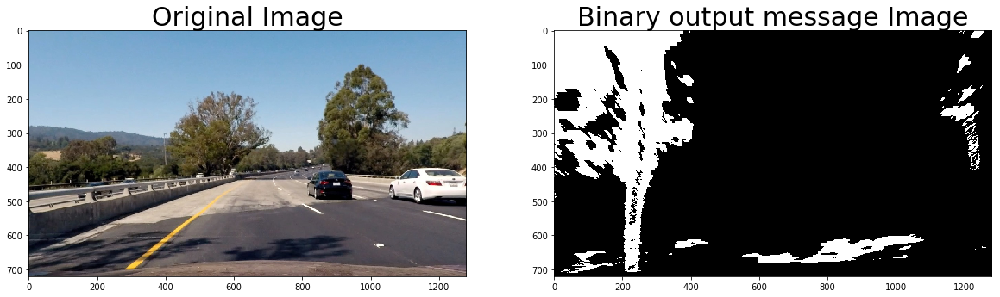

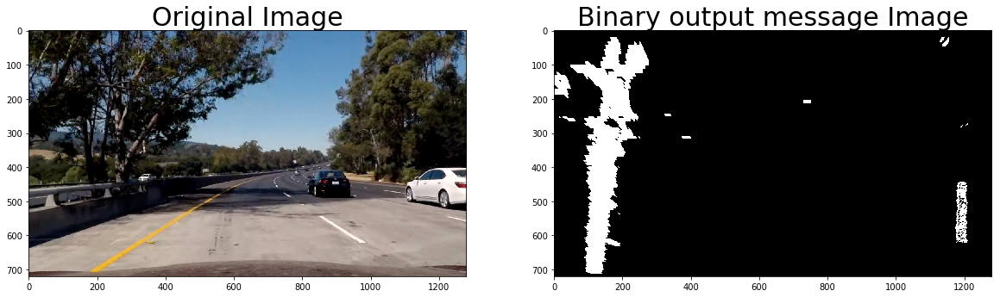

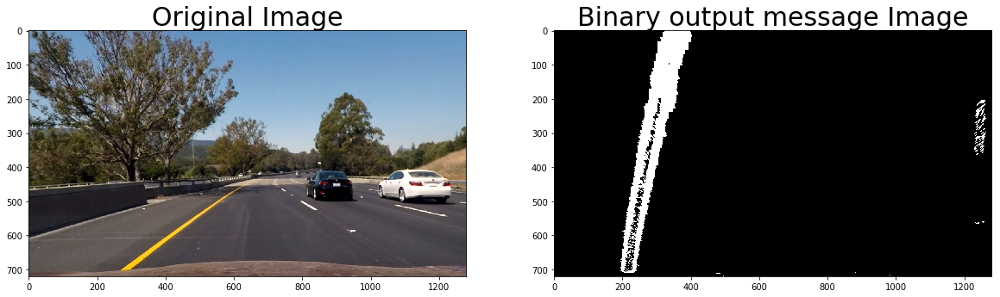

In [17]:

for undist_test_image in undist_test_images:
    undist_test_img = cv2.imread(undist_test_image)
    blur = cv2.GaussianBlur(img,(5,5),0)
    stack_binary_image = stack_binary(blur)
    img_size = stack_binary_image.shape
    ht_window = np.uint(img_size[0]/1.5)
    hb_window = np.uint(img_size[0])
    c_window = np.uint(img_size[1]/2)
    ctl_window = c_window - .2*np.uint(img_size[1]/2)
    ctr_window = c_window + .2*np.uint(img_size[1]/2)
    cbl_window = c_window - .9*np.uint(img_size[1]/2)
    cbr_window = c_window + .9*np.uint(img_size[1]/2)
    src = np.float32([[cbl_window,hb_window],[cbr_window,hb_window],[ctr_window,ht_window],[ctl_window,ht_window]])

    dst = np.float32([[0,img_size[0]],[img_size[1],img_size[0]],
                  [img_size[1],0],[0,0]])

    warped,M_warp,Minv_warp = warp_image(stack_binary_image,src,dst,(img_size[1],img_size[0]))
    image_HSV = cv2.cvtColor(warped,cv2.COLOR_BGR2HSV)
    yellow_hsv_low  = np.array([ 0,  100,  100])
    yellow_hsv_high = np.array([ 80, 255, 255])
    #res_mask = color_mask(image_HSV,yellow_hsv_low,yellow_hsv_high)
    #res = apply_color_mask(image_HSV,warped,yellow_hsv_low,yellow_hsv_high)
    white_hsv_low  = np.array([ 0,   0,   160])
    white_hsv_high = np.array([ 255,  80, 255])

    #white_hsv_low  = np.array([  0,   0,    80])
    #white_hsv_high = np.array([ 255,  255, 255])

    #res1 = apply_color_mask(image_HSV,warped,white_hsv_low,white_hsv_high)
    mask_yellow = color_mask(image_HSV,yellow_hsv_low,yellow_hsv_high)
    mask_white = color_mask(image_HSV,white_hsv_low,white_hsv_high)
    mask_lane = cv2.bitwise_or(mask_yellow,mask_white)

    undist_test_image = cv2.cvtColor(undist_test_img,cv2.COLOR_BGR2RGB)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(undist_test_image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(mask_lane,cmap='gray')
    ax2.set_title('Binary output message Image', fontsize=30)
    #warped_test_images.append(warped_test_image)


### Now I will do analysis of histogram of intensities of the bottom half of the image. I will do it for one of the image.

In [18]:
new_img = cv2.imread('test_images/undist_test4.jpg')

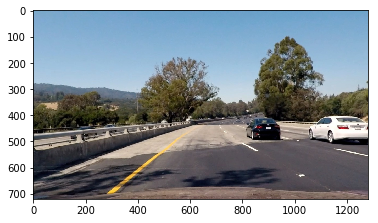

In [19]:
new_img = cv2.cvtColor(new_img, cv2.COLOR_BGR2RGB)
plt.imshow(new_img)

C:\Users\Jyoti\Anaconda3\envs\carnd-term1\lib\site-packages\ipykernel\__main__.py:27: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


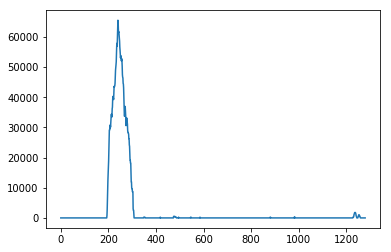

In [24]:
blur = cv2.GaussianBlur(new_img,(5,5),0)
stack_binary_image = stack_binary(blur)
img_size = stack_binary_image.shape
ht_window = np.uint(img_size[0]/1.5)
hb_window = np.uint(img_size[0])
c_window = np.uint(img_size[1]/2)
ctl_window = c_window - .2*np.uint(img_size[1]/2)
ctr_window = c_window + .2*np.uint(img_size[1]/2)
cbl_window = c_window - .9*np.uint(img_size[1]/2)
cbr_window = c_window + .9*np.uint(img_size[1]/2)
src = np.float32([[cbl_window,hb_window],[cbr_window,hb_window],[ctr_window,ht_window],[ctl_window,ht_window]])

dst = np.float32([[0,img_size[0]],[img_size[1],img_size[0]],
                  [img_size[1],0],[0,0]])

warped,M_warp,Minv_warp = warp_image(stack_binary_image,src,dst,(img_size[1],img_size[0]))
image_HSV = cv2.cvtColor(warped,cv2.COLOR_BGR2HSV)
yellow_hsv_low  = np.array([ 0,  100,  100])
yellow_hsv_high = np.array([ 80, 255, 255])
white_hsv_low  = np.array([ 0,   0,   160])
white_hsv_high = np.array([ 255,  80, 255])

mask_yellow = color_mask(image_HSV,yellow_hsv_low,yellow_hsv_high)
mask_white = color_mask(image_HSV,white_hsv_low,white_hsv_high)
pro_img = cv2.bitwise_or(mask_yellow,mask_white)
import numpy as np
histogram = np.sum(pro_img[pro_img.shape[0]/2:,:], axis=0)
plt.plot(histogram)

### I am not getting the right lane again. I will revisit everything again.